In [107]:
import pandas as pd
import networkx as nx
#import graph_tool.all as gt
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from collections import Counter
from node2vec import Node2Vec
from random import sample
from sklearn import model_selection as mod
from sklearn import preprocessing as pre
from sklearn import pipeline as pip
from sklearn import manifold as man
from sklearn import linear_model as lin
from sklearn import decomposition as dec
from sklearn import impute as imp
from sklearn import ensemble as ens
from sklearn import metrics as met
from sklearn import compose as com
import matplotlib.cbook
from sklearn.model_selection import learning_curve

nx.__version__

'2.5'

# Reading The Data

In [5]:
# https://snap.stanford.edu/data/facebook-large-page-page-network.html 

In [3]:
df = pd.read_csv('musae_facebook_target.csv')
df.head()

,id,facebook_id,page_name,page_type
0,0,145647315578475,The Voice of China 中国好声音,tvshow
1,1,191483281412,U.S. Consulate General Mumbai,government
2,2,144761358898518,ESET,company
3,3,568700043198473,Consulate General of Switzerland in Montreal,government
4,4,1408935539376139,Mark Bailey MP - Labor for Miller,politician


In [4]:
df2 = pd.read_csv('musae_facebook_edges.csv')#.set_index('id').transpose().to_dict()
df2.head()

,id_1,id_2
0,0,18427
1,1,21708
2,1,22208
3,1,22171
4,1,6829


# Subgroups

In [5]:
count_dict = {}
for row in df2.itertuples():
    if row.id_1 not in count_dict:
        count_dict[row.id_1] = 1
    else:
        count_dict[row.id_1] += 1
    if row.id_2 not in count_dict:
        count_dict[row.id_2] = 1
    else:
        count_dict[row.id_2] += 1


In [6]:
df["counts"] = df.index.map(count_dict)
df.head()

,id,facebook_id,page_name,page_type,counts
0,0,145647315578475,The Voice of China 中国好声音,tvshow,1
1,1,191483281412,U.S. Consulate General Mumbai,government,34
2,2,144761358898518,ESET,company,12
3,3,568700043198473,Consulate General of Switzerland in Montreal,government,10
4,4,1408935539376139,Mark Bailey MP - Labor for Miller,politician,51


In [10]:
df.sort_values(by=["counts"], ascending=False).head(20)

,id,facebook_id,page_name,page_type,counts
16895,16895,44053938557,U.S. Army,government,709
19743,19743,1191441824276882,The White House,government,678
21729,21729,63811549237,The Obama White House,government,659
14497,14497,404391086302925,U.S. Army Chaplain Corps,government,650
1387,1387,155837727772692,"Honolulu District, U.S. Army Corps of Engineers",government,504
10379,10379,15877306073,U.S. Department of State,government,468
19347,19347,78922439964,FEMA Federal Emergency Management Agency,government,448
21120,21120,178362315106,European Parliament,government,417
2442,2442,212025308879899,Army Training Network (ATN),government,408
8139,8139,136880189673357,Defense Commissary Agency,government,387


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function 

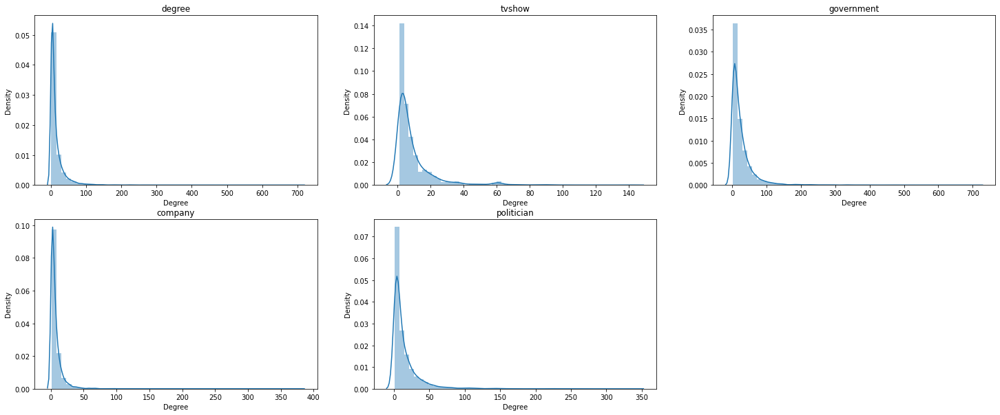

In [11]:
plt.figure(figsize=(25,10))
plt.subplot(2,3,1)
sns.distplot(df.counts)
plt.title("degree")
plt.xlabel("Degree")

t = 2 
for i in df.page_type.unique():
    plt.subplot(2,3,t)
    sns.distplot(df[df.page_type == i]["counts"])
    plt.title(i)
    plt.xlabel("Degree")

    t += 1
plt.show()

<Figure size 1800x720 with 0 Axes>

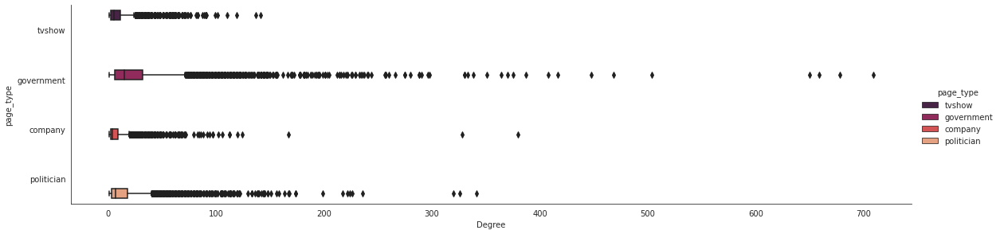

In [68]:
plt.figure(figsize=(25,10))
ax=sns.catplot(x="counts", y="page_type", hue="page_type",kind="box",height=4, aspect=4, orient="h", data=df, palette="rocket")
plt.xlabel("Degree")
plt.show()



> Degree of government pages tend to be higher than others



# Network Analysis

In [7]:
df.drop(columns=["facebook_id","page_name","counts"],axis=1,inplace=True)
df.head()

,id,page_type
0,0,tvshow
1,1,government
2,2,company
3,3,government
4,4,politician


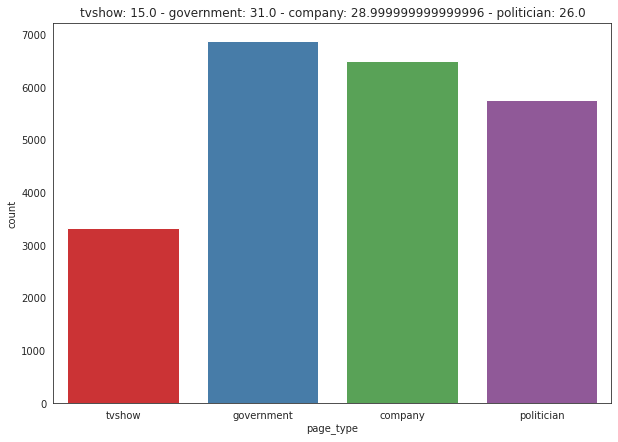

In [ ]:
tvshow_ratio    = (str(round(df[df["page_type"] == "tvshow"]["page_type"].count()/df["page_type"].count(),2)*100))
government_ratio = (str(round(df[df["page_type"] == "government"]["page_type"].count()/df["page_type"].count(),2)*100))
company_ratio   = (str(round(df[df["page_type"] == "company"]["page_type"].count()/df["page_type"].count(),2)*100))
politician_ratio   = (str(round(df[df["page_type"] == "politician"]["page_type"].count()/df["page_type"].count(),2)*100))
sns.set_style("white")
plt.figure(figsize=(10,7))
sns.countplot(x='page_type', data=df, palette="Set1")
plt.title("tvshow: "+ tvshow_ratio + " - government: " + government_ratio +  " - company: " + company_ratio+" - politician: "+politician_ratio)
plt.show()


Classes are not perfectly balanced

In [8]:
G = nx.from_pandas_edgelist(pd.read_csv('musae_facebook_edges.csv', header=0, names = ['source', 'target']), create_using=nx.Graph())

In [9]:
node_attributes = df.set_index('id').transpose().to_dict()

In [ ]:
nx.set_node_attributes(G, node_attributes)
G.nodes(data=True)

In [ ]:
print(nx.info(G))
print()
print("Has Eulerian path: ", nx.has_eulerian_path(G))
print()
print("Is bipartite: ", nx.is_bipartite(G))
print()
#print("Degrees: ", nx.degree(G))
print()
print("Density: ", nx.density(G))
highest_degree_node = max(G.nodes, key=G.degree)
print()
print("Node",highest_degree_node, "has the highest degree and the degree is", G.degree(highest_degree_node))
print()
# If the network is disconnected, shortest path will raise errror. Therefore, I will use try/except.
print("Number of connected components: ",nx.number_connected_components(G))
print("The list of componensts:",list(nx.connected_components(G)))
print()
print("\n"*3)


- Network seems quite sparse. Density is 0.0007
- It is connected

In [ ]:
t = 1
list_clique = []
counter = 0
for i in nx.find_cliques(G):
    list_clique.append(i)
    counter += 1
print()
print("There are",counter,"cliques in the network")
    


There are 255294 cliques in the network


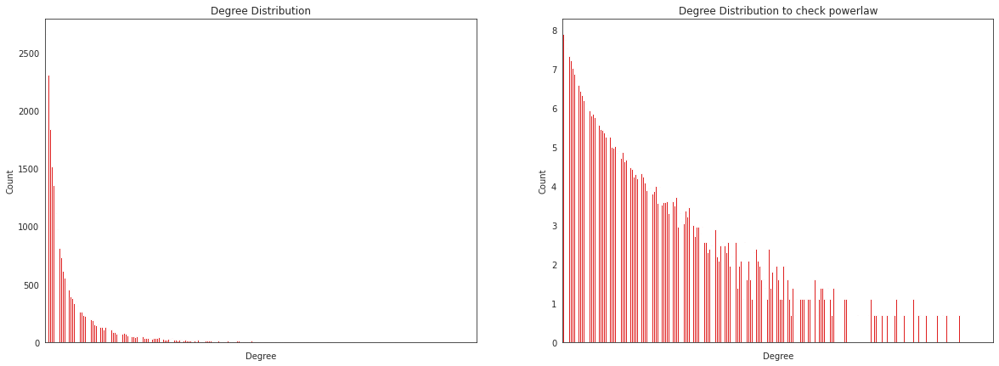

In [ ]:
degrees = pd.DataFrame(G.degree,columns=["Nodes","Degree"])
plt.figure(figsize=(20,7))
plt.subplot(1,2,1)
degree_counts = pd.DataFrame(degrees.groupby(["Degree"]).size().reset_index())
p1 = sns.barplot(x=degree_counts.iloc[:,0],y=degree_counts.iloc[:,1],color="r")
plt.title("Degree Distribution")
plt.ylabel("Count")
p1.set(xticklabels=[])

plt.subplot(1,2,2)
degree_counts = pd.DataFrame(degrees.groupby(["Degree"]).size().reset_index())
p2 = sns.barplot(x=round(np.log(degree_counts.iloc[:,0]),3),y=np.log(degree_counts.iloc[:,1]),color="r")
plt.title("Degree Distribution to check powerlaw")
plt.ylabel("Count")
p2.set(xticklabels=[])
plt.show()


network follows powerlaw

In [ ]:
dgc = nx.degree_centrality(G)
eig = nx.eigenvector_centrality(G)
#ktz = nx.katz_centrality(G)
pgr = nx.pagerank(G)
btw = nx.betweenness_centrality(G)
cr = pd.DataFrame(index=G.nodes())
cls = nx.closeness_centrality(G)

#cr['katz'] = cr.index.map(ktz)
cr['pagerank'] = cr.index.map(pgr)
cr['closeness_centrality'] = cr.index.map(cls)
cr['degree'] = cr.index.map(G.degree())
cr['degree_centrality'] = cr.index.map(dgc)
cr['eigenvector_centrality'] = cr.index.map(eig)
cr['betweenness_centrality'] = cr.index.map(btw)
cr['clustring_coef']= cr.index.map(nx.clustering(G))
cr['eigenvector_centrality'] = round(cr.eigenvector_centrality,4)


In [ ]:
t = 1
list_clique = []
counter = 0
for i in nx.find_cliques(G):
    list_clique.append(i)
    counter += 1
print()
print("There are",counter,"cliques in the network")



There are 255294 cliques in the network


In [ ]:
clique_num_each_node = {}
for j in range(len(list_clique)):
    for i in range(len(list_clique[j])):
        key = list_clique[j][i]
        if key not in clique_num_each_node:
            clique_num_each_node[key] = 1
        else: 
            clique_num_each_node[key] += 1

In [ ]:
number_of_cliques = pd.DataFrame([clique_num_each_node]).T
number_of_cliques =  number_of_cliques.rename(columns={0:"number_of_cliques"})
print(number_of_cliques.shape)
print(cr.shape)
number_of_cliques.head()

(22470, 1)
(22470, 5)


,number_of_cliques
0,1
18427,52
1,132
18304,30
10281,11


In [ ]:
cr = cr.merge(number_of_cliques,left_index=True, right_index=True)

In [46]:
size_maximal_clique = {}
for i in list(G.nodes()):
    num = nx.algorithms.clique.node_clique_number(G, nodes=i, cliques=None)
    if i not in size_maximal_clique:
        size_maximal_clique[i] = num

In [49]:
cr["size_maximal_clique"] = cr.index.map(size_maximal_clique)

In [52]:
cr.to_excel("cr.xlsx")

In [73]:
cr = pd.read_excel("cr.xlsx",index_col=0)

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


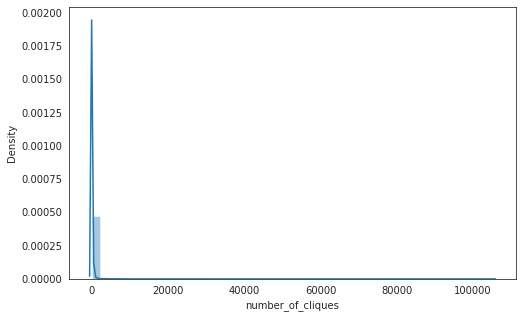

In [ ]:
plt.figure(figsize=(8,5))
sns.distplot(cr['number_of_cliques'],kde=True,)
plt.show()

In [ ]:
#Centralities of the nodes
t = 1
plt.figure(figsize=(20,15))
for i in cr.columns:
    plt.subplot(2,3,t)
    sns.barplot(x=cr.index,y=cr[i])
    t += 1
plt.show()

# Community Detection

In [ ]:
from networkx.algorithms import community as nxcomm
kl_res = nxcomm.kernighan_lin_bisection(G)
print(kl_res)
print("Modularity",nxcomm.quality.modularity(G, communities = kl_res))


In [ ]:
gmc_res = nxcomm.greedy_modularity_communities(G)
gmc_res


In [ ]:
len(gmc_res)

130

In [ ]:
nxcomm.quality.modularity(G, communities = gmc_res)

0.7296619832182506

modularity is quite high. There exists a community structure.

In [ ]:
community_num_each_node = {}
for j in range(len(gmc_res)):
    list_to_iterate = list(gmc_res[j])
    for i in range(len(list_to_iterate)):
        key = list_to_iterate[i]
        if key not in community_num_each_node:
            community_num_each_node[key] = j

In [ ]:
number_of_communities = pd.DataFrame([community_num_each_node]).T
number_of_communities =  number_of_communities.rename(columns={0:"number_of_communities"})
print(number_of_communities.shape)
print(cr.shape)
number_of_communities.head()

(22470, 1)
(22470, 8)


,number_of_communities
3,0
4,0
5,0
6,0
13,0


In [ ]:
cr = cr.merge(number_of_communities,left_index=True, right_index=True)

C:\ProgramData\Anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


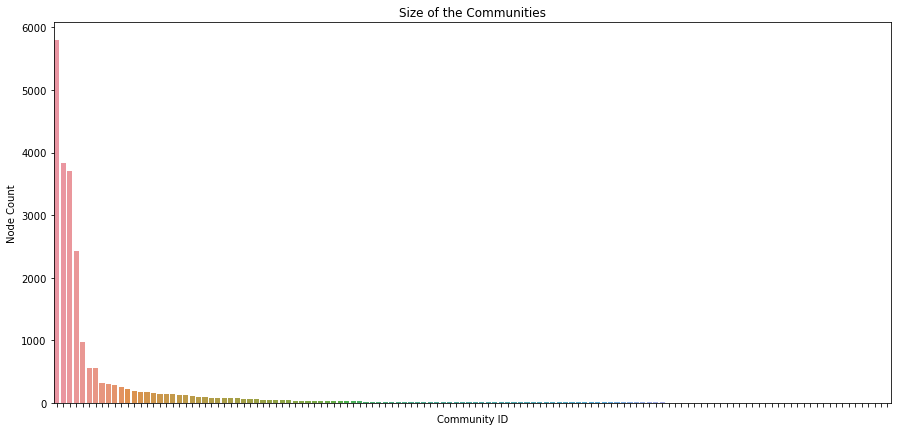

In [86]:
plt.figure(figsize=(15,7))
p = sns.barplot(cr.number_of_communities.value_counts().index,cr.number_of_communities.value_counts().values)
plt.title("Size of the Communities")
plt.ylabel("Node Count")
plt.xlabel("Community ID")
p.set(xticklabels=[])
plt.show()

In [78]:
cr["size_community"] = cr.number_of_communities.map(dict(cr.number_of_communities.value_counts()))

In [82]:
cr.to_excel("cr.xlsx")

In [83]:
cr = pd.read_excel("cr.xlsx",index_col=0)
cr.head()

,degree_centrality,eigenvector_centrality,betweenness_centrality,clustring_coef,pagerank,closeness_centrality,degree,number_of_cliques,number_of_communities,size_maximal_clique,size_community
0,0.000045,0.0000,0.000000,0.000000,0.000014,0.182482,1,1,5,2,564
18427,0.002270,0.0000,0.005182,0.024314,0.000452,0.223212,51,52,5,4,564
1,0.001513,0.0080,0.000153,0.481283,0.000050,0.257752,34,132,2,11,3704
21708,0.008679,0.0256,0.002415,0.144647,0.000266,0.285807,195,3863,2,14,3704
22208,0.009124,0.0345,0.002421,0.122669,0.000272,0.283746,205,2744,2,15,3704


In [84]:
cr.describe().T

,count,mean,std,min,25%,50%,75%,max
degree_centrality,22470.0,0.000677,0.001176,0.000045,1.335173e-04,0.000312,0.000757,0.031555
eigenvector_centrality,22470.0,0.001308,0.006542,0.000000,0.000000e+00,0.000000,0.000100,0.177800
betweenness_centrality,22470.0,0.000177,0.001250,0.000000,9.382567e-08,0.000011,0.000099,0.115790
clustring_coef,22470.0,0.359738,0.318213,0.000000,4.395604e-02,0.326840,0.582418,1.000000
pagerank,22470.0,0.000045,0.000047,0.000008,1.909433e-05,0.000033,0.000054,0.001322
closeness_centrality,22470.0,0.205662,0.029688,0.097787,1.860113e-01,0.206864,0.225638,0.324158
degree,22470.0,15.220472,26.414431,1.000000,3.000000e+00,7.000000,17.000000,709.000000
number_of_cliques,22470.0,105.981887,1402.646206,1.000000,2.000000e+00,4.000000,14.000000,105326.000000
number_of_communities,22470.0,6.397997,13.804081,0.000000,0.000000e+00,2.000000,5.000000,129.000000
size_maximal_clique,22470.0,6.004450,5.345400,2.000000,3.000000e+00,4.000000,7.000000,55.000000


## Network Plot

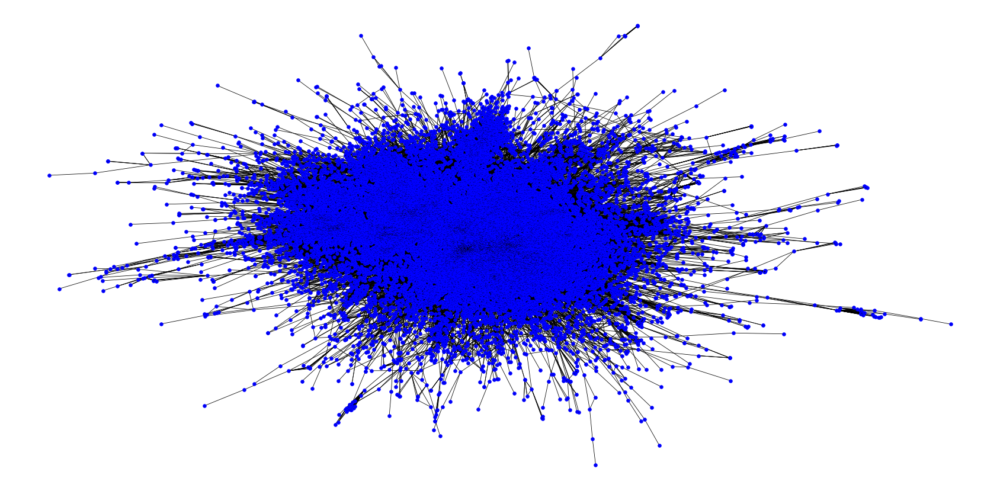

In [85]:
plt.rcParams['figure.figsize'] = [30, 15]
pos = nx.spring_layout(G, seed = 1)
nx.draw_networkx_nodes(G, pos, node_color='b',node_size=30)
nx.draw_networkx_edges(G, pos, edgelist=G.edges(),width=0.8)
nx.draw_networkx_labels(G, pos, font_family="sans-serif",font_size =0)
ax = plt.gca()
plt.axis("off")
plt.show()

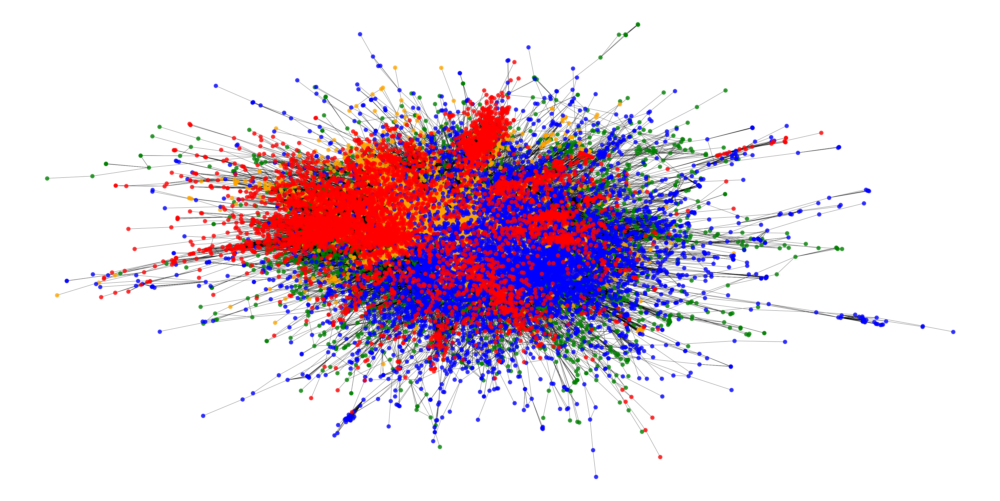

In [118]:
G1 = nx.from_pandas_edgelist(pd.read_csv('musae_facebook_edges.csv', header=0, names = ['source', 'target']), create_using=nx.Graph())
df2 = df.copy()
df2.page_type = df2.page_type.map({"tvshow":1,"government":2,"company":3,"politician":4})
lt1 = list(df2[df2.page_type == 1 ].index)
lt2 = list(df2[df2.page_type == 2 ].index)
lt3 = list(df2[df2.page_type == 3 ].index)
lt4 = list(df2[df2.page_type == 4 ].index)
node_attributes2 = df2.set_index('id').transpose().to_dict()
node_attributes2 = df2.set_index('id').transpose().to_dict()
nx.set_node_attributes(G1, node_attributes2)
G1.nodes(data=True)

plt.rcParams['figure.figsize'] = [60, 30]

nx.draw(G1, pos, edge_color='k',  with_labels=False,
         font_weight='light', node_size= 5, width= 0.8)

#For each community list, draw the nodes, giving it a specific color.
nx.draw_networkx_nodes(G1, pos, nodelist=lt1, node_color='g',alpha=0.8) # tvshow
nx.draw_networkx_nodes(G1, pos, nodelist=lt2, node_color='orange',alpha=0.8) # government
nx.draw_networkx_nodes(G1, pos, nodelist=lt3, node_color='b',alpha=0.8) # company
nx.draw_networkx_nodes(G1, pos, nodelist=lt4, node_color='r',alpha=0.8) # politician
plt.axis("off")
plt.show()

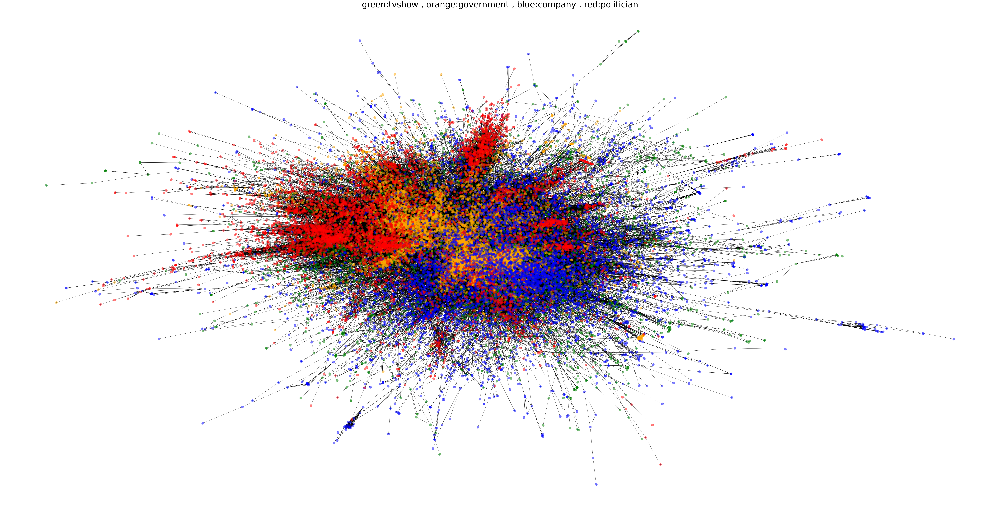

In [122]:
plt.rcParams['figure.figsize'] = [100, 50]

nx.draw(G1, pos, edge_color='k',  with_labels=False,
         font_weight='light', node_size= 5, width= 0.8)

nx.draw_networkx_nodes(G1, pos, nodelist=lt1, node_color='g',alpha=0.5)      # tvshow
nx.draw_networkx_nodes(G1, pos, nodelist=lt2, node_color='orange',alpha=0.5) # government
nx.draw_networkx_nodes(G1, pos, nodelist=lt3, node_color='b',alpha=0.5)      # company
nx.draw_networkx_nodes(G1, pos, nodelist=lt4, node_color='r',alpha=0.5)      # politician
plt.axis("off")
plt.title("green:tvshow , orange:government , blue:company , red:politician", fontsize=60)
plt.show()

# Helper Functions

In [11]:
# Ref: http://scikit-learn.org/stable/modules/learning_curve.html
def plot_learning_curve(estimator, title, X, y, ylim=None, cv=None,
                        n_jobs=1, train_sizes=np.linspace(0.01, 1.0, 5),scoring="f1"):
    plt.figure(figsize=(10,6))
    plt.title(title)
    if ylim is not None:
        plt.ylim(*ylim)
    plt.xlabel("Training examples")
    plt.ylabel("Score")
    train_sizes, train_scores, test_scores = learning_curve(
        estimator, X, y, cv=cv, n_jobs=n_jobs, train_sizes=train_sizes,scoring=scoring)
    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)

    plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                     train_scores_mean + train_scores_std, alpha=0.1,
                     color="r")
    plt.fill_between(train_sizes, test_scores_mean - test_scores_std,
                     test_scores_mean + test_scores_std, alpha=0.1, color="g")
    plt.plot(train_sizes, train_scores_mean, '-', color="r",
             label="Training score")
    plt.plot(train_sizes, test_scores_mean, '-', color="g",
             label="Cross-validation score")

    plt.legend(loc="best")
    plt.grid("on")
    return plt

In [12]:
def ROC_plotter(y_train_,y_test_,X_train_,X_test_,estimator):
    plt.figure(figsize=(14,4))
    plt.subplot(121)
    fpr, tpr, tresholds = met.roc_curve(y_train_ , estimator.predict_proba(X_train_)[:,1])
    roc_auc = met.roc_auc_score(y_train_ , estimator.predict_proba(X_train_)[:,1])
    plt.plot(fpr, tpr, label='ROC-AUC = %0.2f' % roc_auc, color='darkorange', linestyle='dashdot', lw=2)
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC Curve - Train ')
    plt.legend(loc="lower right")
    plt.subplot(122)
    fpr, tpr, tresholds = met.roc_curve(y_test_ , estimator.predict_proba(X_test_)[:,1] )
    roc_auc = met.roc_auc_score(y_test_ , estimator.predict_proba(X_test_)[:,1])
    plt.plot(fpr, tpr, label='ROC-AUC = %0.2f' % roc_auc, color='darkorange', linestyle='dashdot', lw=2)
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC Curve - Test')
    plt.legend(loc="lower right")
    plt.show()

def PrecisionRecallCurve(y_train_,y_test_,X_train_,X_test_,estimator):
    plt.figure(figsize=(14,4))
    plt.subplot(121)
    plt.title("Precision vs Recall Training")
    precision, recall, tresholds = met.precision_recall_curve(y_train_,estimator.predict_proba(X_train_)[:,1])
    plt.plot(tresholds,precision[:-1],"--",color="navy",label="Precison: TP / (TP+FP)")
    plt.plot(tresholds,recall[:-1],"--",color="darkorange",label='Recall: TP / (TP+FN)')
    plt.legend()
    plt.subplot(122)
    plt.title("Precision vs Recall Test")
    precision, recall, tresholds = met.precision_recall_curve(y_test_,estimator.predict_proba(X_test_)[:,1])
    plt.plot(tresholds,precision[:-1],"--",color="navy",label="Precison: TP / (TP+FP)")
    plt.plot(tresholds,recall[:-1],"--",color="darkorange",label='Recall: TP / (TP+FN)')
    plt.legend()
    plt.show()
    
def PrecisionRecallCurve2(y_train_,y_test_,X_train_,X_test_,estimator):
    plt.figure(figsize=(14,4))
    plt.subplot(121)
    plt.title("Precision vs Recall Training")
    precision, recall, tresholds = met.precision_recall_curve(y_train_,estimator.predict_proba(X_train_)[:,1])
    pr_auc = met.auc(recall, precision)
    plt.plot(recall,precision,"--",color="darkorange",label='LR (PR-AUC = %0.2f)' % pr_auc)
    no_skill = len(y_train_[y_train_==1]) / len(y_train_)
    plt.plot([0, 1], [no_skill, no_skill], linestyle='--', color='navy', label='No Skill')
    plt.legend()
    plt.xlabel("precision")
    plt.ylabel("recall")
    plt.title("precision recall curve")
    plt.subplot(122)
    plt.title("Precision vs Recall Test")
    precision, recall, tresholds = met.precision_recall_curve(y_test_,estimator.predict_proba(X_test_)[:,1])
    pr_auc = met.auc(recall, precision)
    plt.plot(recall,precision,"--",color="darkorange",label='LR (PR-AUC = %0.2f)' % pr_auc)
    no_skill = len(y_test[y_test==1]) / len(y_test)
    plt.plot([0, 1], [no_skill, no_skill], linestyle='--', color='navy', label='No Skill')
    plt.legend()
    plt.xlabel("precision")
    plt.ylabel("recall")
    plt.show()

# Modelling with Hand Engineered Features

In [87]:
modelling_data = cr.merge(df, left_index=True,right_index=True).drop(columns=["id"])

In [96]:
modelling_data.head(2)

,degree_centrality,eigenvector_centrality,betweenness_centrality,clustring_coef,pagerank,closeness_centrality,degree,number_of_cliques,number_of_communities,size_maximal_clique,size_community,page_type
0,0.000045,0.0,0.000000,0.000000,0.000014,0.182482,1,1,5,2,564,tvshow
18427,0.002270,0.0,0.005182,0.024314,0.000452,0.223212,51,52,5,4,564,tvshow


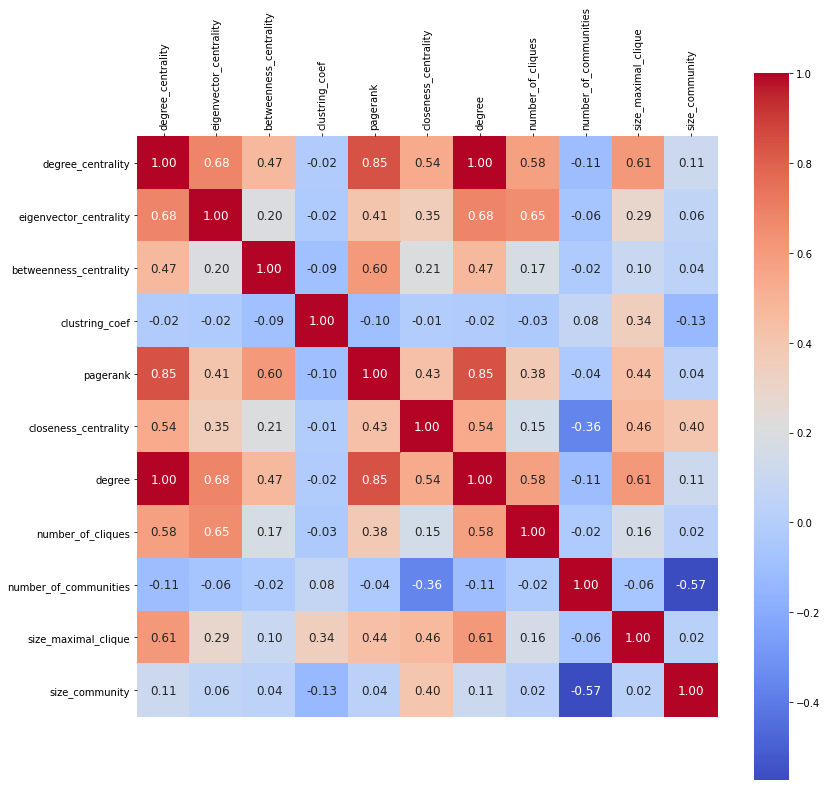

In [89]:
correlation_matrix = modelling_data.corr()
plt.figure(figsize=(13,13))
ax = sns.heatmap(correlation_matrix, vmax=1, cbar=True, square=True, annot=True, fmt='.2f', 
                 annot_kws={'size': 12}, cmap='coolwarm')
ax.xaxis.set_ticks_position('top')
plt.yticks(rotation=0)
plt.xticks(rotation=90)
plt.show()

In [97]:
X = modelling_data.iloc[:,:-1]
y = modelling_data.iloc[:,-1]

In [98]:
num_list = list(X.columns)
num_list

['degree_centrality',
 'eigenvector_centrality',
 'betweenness_centrality',
 'clustring_coef',
 'pagerank',
 'closeness_centrality',
 'degree',
 'number_of_cliques',
 'number_of_communities',
 'size_maximal_clique',
 'size_community']

In [99]:
num_list.remove("number_of_communities")
num_list

['degree_centrality',
 'eigenvector_centrality',
 'betweenness_centrality',
 'clustring_coef',
 'pagerank',
 'closeness_centrality',
 'degree',
 'number_of_cliques',
 'size_maximal_clique',
 'size_community']

In [108]:
pipe_categoric = pip.Pipeline([
                                ("ohe",pre.OneHotEncoder(handle_unknown="ignore", sparse=False,))
                              ])
pipe_numeric = pip.Pipeline([
                                ("scaler", pre.StandardScaler())
                             ])

ct = com.ColumnTransformer([
              ("num", pipe_numeric, num_list),
              ("cat", pipe_categoric, ["number_of_communities"]), # This columns includes community Id. It needs to be one hot encoded
],remainder="passthrough")

In [79]:
pipe_tsne = pip.Pipeline([
              ("ct", ct),
              ("tsne", man.TSNE(n_components=2))
])
X_tsne = pipe_tsne.fit_transform(X)

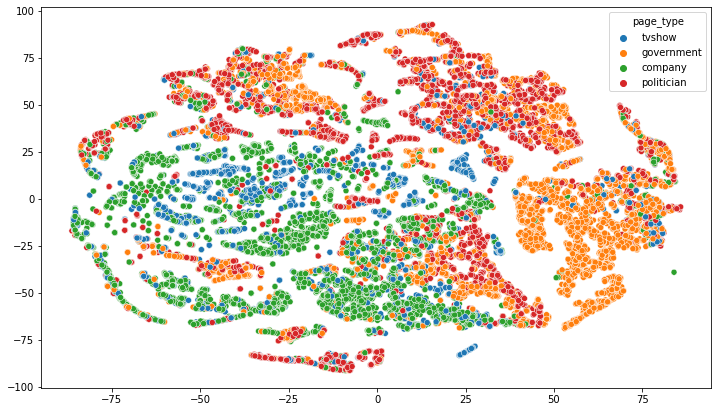

In [80]:
plt.figure(figsize=(12,7))
sns.scatterplot(x=X_tsne[:, 0], y=X_tsne[:,1], hue=y)
plt.show()

It seems we will need more complex features. I will use PCA and check if there is any improvement 

In [111]:
def plot_component_cumulative_importance(pipe_pca, stepName):
  ratios = pipe_pca.named_steps[stepName].explained_variance_ratio_

  x_values = []
  y_values = []

  total = 0
  for i in range(0, len(ratios)):
    x_values.append(i+1)
    total += ratios[i]
    y_values.append(total)
  plt.figure(figsize=(15,7))
  plt.plot(x_values, y_values)
  plt.xlabel("Feature Number")
  plt.ylabel("Explained Variance")
  plt.grid(True)
  plt.show()

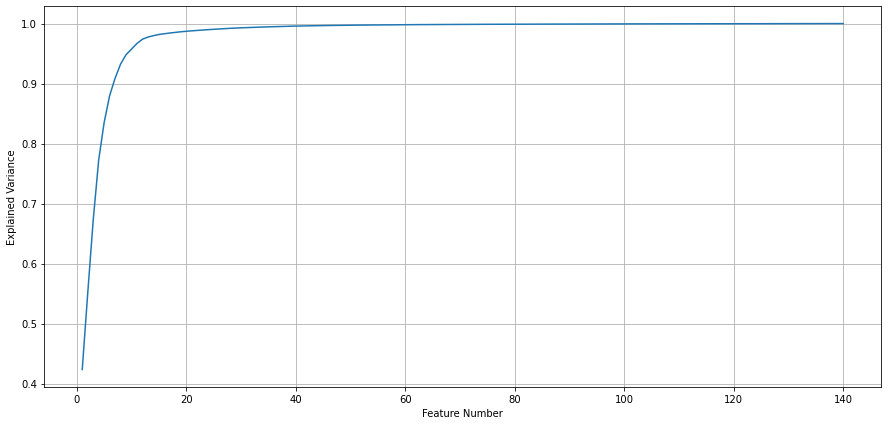

In [112]:
pipe_pca = pip.Pipeline([
            ("ct", ct),
            ("pca", dec.PCA()),
            
])
pipe_pca.fit(X)
plot_component_cumulative_importance(pipe_pca, "pca")

20 features seems okay for PCA to avoid unnecessary complexity of features

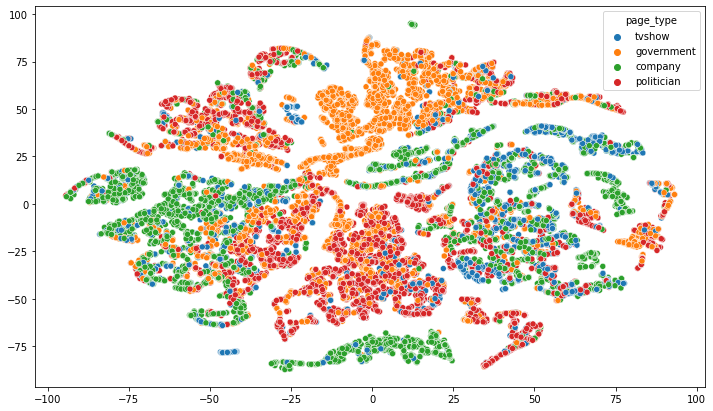

In [113]:
pipe_pca_tsne = pip.Pipeline([
              ("ct", ct),
              ("pca", dec.PCA(n_components=20)),
              ("tsne", man.TSNE(n_components=2))
])
X_tsne = pipe_pca_tsne.fit_transform(X)
plt.figure(figsize=(12,7))
sns.scatterplot(x=X_tsne[:, 0], y=X_tsne[:,1], hue=y)
plt.show()

In [120]:
X_train, X_test, y_train, y_test = mod.train_test_split(X, y, test_size=0.2, random_state=42, stratify = y)

In [ ]:
# Logistic Regression without PCA

In [50]:
pipeline = pip.Pipeline( steps = [("ct", ct),
                                  #("pca", dec.PCA(n_components=20)),
                                  ('clf', lin.LogisticRegression(random_state=42))
                             ])
params_lr = [  {'clf__C'      : np.arange(0.1, 1, 0.1),
               'clf__penalty': ['l1'], 
               'clf__solver' : ['liblinear']},
               {'clf__C'      : np.arange(0.1, 1, 0.1), 
               'clf__penalty': ['l2'], 
               'clf__solver' : ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga']}  
              ] 
#Kfold Stratified
kfold = mod.StratifiedKFold(n_splits=3)
grid = mod.GridSearchCV(estimator = pipeline, param_grid = params_lr, cv = kfold,verbose=1, n_jobs = -1)
grid.fit(X_train,y_train)
print('Grid accuracy on training data:', grid.score(X_train, y_train))
print('Grid accuracy on test data:', grid.score(X_test, y_test))
print("train")
print(met.classification_report(y_train, grid.predict(X_train)))
print("test")
print(met.classification_report(y_test, grid.predict(X_test)))

Fitting 3 folds for each of 54 candidates, totalling 162 fits
Grid accuracy on training data: 0.6953716065865598
Grid accuracy on test data: 0.6906987093902982
train
              precision    recall  f1-score   support

           1       0.73      0.69      0.71      5504
           2       0.72      0.82      0.76      5196
           3       0.62      0.70      0.66      4614
           4       0.77      0.44      0.56      2662

    accuracy                           0.70     17976
   macro avg       0.71      0.66      0.67     17976
weighted avg       0.70      0.70      0.69     17976

test
              precision    recall  f1-score   support

           1       0.73      0.68      0.70      1376
           2       0.71      0.82      0.76      1299
           3       0.61      0.71      0.66      1154
           4       0.76      0.43      0.55       665

    accuracy                           0.69      4494
   macro avg       0.70      0.66      0.67      4494
weighted avg  

In [ ]:
# Logistic Regression with PCA

In [51]:
pipeline = pip.Pipeline( steps = [("ct", ct),
                                  ("pca", dec.PCA(n_components=20)),
                                  ('clf', lin.LogisticRegression(random_state=42))
                             ])
params_lr = [  {'clf__C'      : np.arange(0.1, 1, 0.1),
               'clf__penalty': ['l1'], 
               'clf__solver' : ['liblinear']},
               {'clf__C'      : np.arange(0.1, 1, 0.1), 
               'clf__penalty': ['l2'], 
               'clf__solver' : ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga']}  
              ] 
#Kfold Stratified
kfold = mod.StratifiedKFold(n_splits=3)
grid = mod.GridSearchCV(estimator = pipeline, param_grid = params_lr, cv = kfold,verbose=1, n_jobs = -1)
grid.fit(X_train,y_train)
print('Grid accuracy on training data:', grid.score(X_train, y_train))
print('Grid accuracy on test data:', grid.score(X_test, y_test))
print("train")
print(met.classification_report(y_train, grid.predict(X_train)))
print("test")
print(met.classification_report(y_test, grid.predict(X_test)))

Fitting 3 folds for each of 54 candidates, totalling 162 fits
Grid accuracy on training data: 0.6466399643969737
Grid accuracy on test data: 0.6397418780596351
train
              precision    recall  f1-score   support

           1       0.72      0.68      0.70      5504
           2       0.66      0.78      0.71      5196
           3       0.60      0.64      0.62      4614
           4       0.52      0.34      0.41      2662

    accuracy                           0.65     17976
   macro avg       0.62      0.61      0.61     17976
weighted avg       0.64      0.65      0.64     17976

test
              precision    recall  f1-score   support

           1       0.72      0.67      0.69      1376
           2       0.66      0.78      0.71      1299
           3       0.59      0.63      0.61      1154
           4       0.49      0.34      0.40       665

    accuracy                           0.64      4494
   macro avg       0.61      0.60      0.60      4494
weighted avg  

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


PCA did not bring any further improvement on sparse training data. We will try a tree based algorithm.

In [ ]:
# Random Forest without PCA

In [58]:
pipeline = pip.Pipeline(steps=[ ("ct", ct),
                                ('clf', ens.RandomForestClassifier(random_state=42))
                              ])
params = {
    'clf__criterion': ['entropy', 'gini'],
    'clf__max_features': [6,8,10],
    'clf__max_depth': [6, 8,10],
    'clf__min_samples_leaf': [1, 2],
    'clf__min_samples_split': [2, 3],
    'clf__class_weight':[ "balance_subsample","balanced",None]}

kfold = mod.StratifiedKFold(n_splits=3)
grid  = mod.GridSearchCV(estimator=pipeline, param_grid=params, cv=kfold, scoring=met.make_scorer(met.f1_score, average='weighted'),verbose=1,n_jobs=-1)
grid.fit(X_train,y_train)
print(); print("Best CV score: %f using %s\n" % (grid.best_score_, grid.best_params_))
print('Grid accuracy on training data:', grid.score(X_train, y_train))
print('Grid accuracy on test data:', grid.score(X_test, y_test))
print("Training")
print(met.classification_report(y_train, grid.predict(X_train)))
print("Test")
print(met.classification_report(y_test, grid.predict(X_test)))


Fitting 3 folds for each of 216 candidates, totalling 648 fits


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_search.py:918: UserWarning: One or more of the test scores are non-finite: [       nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
 0.65051018 0.65199535 0.64815717 0.64815717 0.651966


Best CV score: 0.703285 using {'clf__class_weight': 'balanced', 'clf__criterion': 'gini', 'clf__max_depth': 10, 'clf__max_features': 6, 'clf__min_samples_leaf': 1, 'clf__min_samples_split': 2}

Grid accuracy on training data: 0.7432650901936351
Grid accuracy on test data: 0.6903425631096599
Training
              precision    recall  f1-score   support

           1       0.84      0.68      0.75      5504
           2       0.76      0.85      0.80      5196
           3       0.69      0.81      0.75      4614
           4       0.66      0.57      0.61      2662

    accuracy                           0.75     17976
   macro avg       0.74      0.73      0.73     17976
weighted avg       0.75      0.75      0.74     17976

Test
              precision    recall  f1-score   support

           1       0.80      0.63      0.70      1376
           2       0.72      0.80      0.76      1299
           3       0.63      0.76      0.69      1154
           4       0.59      0.49      0.

In [70]:
importances = grid.best_estimator_.named_steps["clf"].feature_importances_
std = np.std([grid.best_estimator_.named_steps["clf"].feature_importances_ for tree in  grid.best_estimator_.named_steps["clf"].estimators_], axis=0)
indices = np.argsort(importances)[::-1]
feature_names = X_train.columns.tolist()
# Print the feature ranking
print("Feature ranking:")
feature_list = []
for f in range(11):
#    print("%d. feature %d (%f)" % (f + 1, indices[f], importances[indices[f]]))
    feature_list.append(feature_names[indices[f]])
    print("%2d. %15s %2d (%f)" % (f + 1, feature_names[indices[f]], indices[f], importances[indices[f]]))


Feature ranking:
 1. eigenvector_centrality  1 (0.122035)
 2. closeness_centrality  5 (0.114632)
 3. number_of_cliques  7 (0.075626)
 4.       page_name 10 (0.073584)
 5.  clustring_coef  3 (0.073200)
 6.     facebook_id  9 (0.068978)
 7.        pagerank  4 (0.058983)
 8.          degree  6 (0.054087)
 9. degree_centrality  0 (0.050396)
10. betweenness_centrality  2 (0.042356)
11. number_of_communities  8 (0.042042)


In [ ]:
# Random Forest with PCA

In [121]:
pipeline = pip.Pipeline(steps=[ ("ct", ct),
                                ("pca", dec.PCA(n_components=20)),
                                ('clf', ens.RandomForestClassifier(random_state=42))
                              ])
params = {
    'clf__criterion': ['entropy', 'gini'],
    'clf__max_features': [4,6,8],
    'clf__max_depth': [6, 8,10],
    'clf__min_samples_leaf': [1, 2],
    'clf__min_samples_split': [2, 3],
    'clf__class_weight':[ "balance_subsample","balanced",None]}

kfold = mod.StratifiedKFold(n_splits=3)
grid  = mod.GridSearchCV(estimator=pipeline, param_grid=params, cv=kfold, scoring=met.make_scorer(met.f1_score, average='weighted'),verbose=1,n_jobs=-1)
grid.fit(X_train,y_train)
print(); print("Best CV score: %f using %s\n" % (grid.best_score_, grid.best_params_))
print('Grid accuracy on training data:', grid.score(X_train, y_train))
print('Grid accuracy on test data:', grid.score(X_test, y_test))
print("Training")
print(met.classification_report(y_train, grid.predict(X_train)))
print("Test")
print(met.classification_report(y_test, grid.predict(X_test)))


Fitting 3 folds for each of 216 candidates, totalling 648 fits


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_search.py:918: UserWarning: One or more of the test scores are non-finite: [       nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
 0.66948441 0.67159174 0.67137327 0.66983481 0.677289


Best CV score: 0.721362 using {'clf__class_weight': 'balanced', 'clf__criterion': 'gini', 'clf__max_depth': 10, 'clf__max_features': 8, 'clf__min_samples_leaf': 1, 'clf__min_samples_split': 3}

Grid accuracy on training data: 0.7855108449792223
Grid accuracy on test data: 0.7349530938005929
Training
              precision    recall  f1-score   support

     company       0.79      0.84      0.82      5196
  government       0.89      0.77      0.83      5504
  politician       0.73      0.86      0.79      4614
      tvshow       0.69      0.59      0.63      2662

    accuracy                           0.79     17976
   macro avg       0.78      0.76      0.77     17976
weighted avg       0.79      0.79      0.79     17976

Test
              precision    recall  f1-score   support

     company       0.77      0.81      0.79      1299
  government       0.83      0.72      0.77      1376
  politician       0.67      0.80      0.73      1154
      tvshow       0.62      0.52      0.

PCA improved the results.


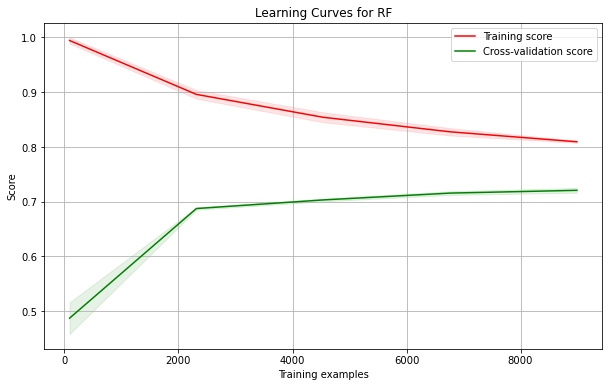

In [72]:
title = 'Learning Curves for RF'
kfold = mod.StratifiedKFold(n_splits=2, shuffle=True, random_state=42)
plot_learning_curve(grid.best_estimator_, title, X_train, y_train, cv=kfold,scoring=met.make_scorer(met.f1_score, average='weighted'))
plt.show()

Results can be improved

# Representation Learning 

In [36]:
# Automated Node2Vec

Node2vec Grid Strategy:

    - Handmaid features' performance is not bad.Therefore, we will choose dimension parameters' values less than default (128) to not making the model too complex.
    - 64 is half of default and 16 is for the efficiency in run time. 
    - 80 is default and 40 is half of the default.
    - combinations of p and q values cover both DFS and BFS.
    - There are 36 different combinations of the parameters. We will save all to files to make node2vec features reusable. Based on trials above, using the 36 different feature file, we will a narrowed RandomForest Grid. 
    - We aim to maximize weighted F1 score to maximize precision and recall for all classes
    - We aim (minimum)  0.85 weighted F1
    - If we cannot get these result, we will keep tuning the node2vec features.

In [31]:
parameters = {
                "dimensions":[16,64],
                "walk_length":[40,80],
                "p":[0.5,1,2],
                "q":[0.5,1,2] 
             }

In [22]:
hand_maid = num_list + ["number_of_communities"]

In [32]:
t = 4 
file_name = []
grid_name = []
t_list    = []

for i in range(len(parameters["dimensions"])):
    for j in range(len(parameters["walk_length"])):
        for k in range(len(parameters["p"])):
            for l in  range(len(parameters["q"])):
                grid_string = "d_"+str(parameters["dimensions"][i]) + "_w_" +str(parameters["walk_length"][j]) + "_p_"+str(parameters["p"][k])+"_q_"+str(parameters["q"][l])
                print(grid_string)
                file_string = "embs" + str(t) + ".txt"
                n2v = Node2Vec(G, dimensions=parameters["dimensions"][i], walk_length=parameters["walk_length"][j], num_walks=10, p = parameters["p"][k], q = parameters["q"][l], workers=4, seed=42) 
                model = n2v.fit(window=10)                
                model.wv.save_word2vec_format(file_string)
                print("saved_"+file_string)
                t_list.append(t)
                file_name.append(file_string)
                grid_name.append(grid_string)
                t += 1

d_16_w_40_p_0.5_q_0.5



saved_embs4.txt
d_16_w_40_p_0.5_q_1



saved_embs5.txt
d_16_w_40_p_0.5_q_2



saved_embs6.txt
d_16_w_40_p_1_q_0.5



saved_embs7.txt
d_16_w_40_p_1_q_1



saved_embs8.txt
d_16_w_40_p_1_q_2



saved_embs9.txt
d_16_w_40_p_2_q_0.5



saved_embs10.txt
d_16_w_40_p_2_q_1



saved_embs11.txt
d_16_w_40_p_2_q_2



saved_embs12.txt
d_16_w_80_p_0.5_q_0.5



saved_embs13.txt
d_16_w_80_p_0.5_q_1



saved_embs14.txt
d_16_w_80_p_0.5_q_2



saved_embs15.txt
d_16_w_80_p_1_q_0.5



saved_embs16.txt
d_16_w_80_p_1_q_1



saved_embs17.txt
d_16_w_80_p_1_q_2



saved_embs18.txt
d_16_w_80_p_2_q_0.5



saved_embs19.txt
d_16_w_80_p_2_q_1



saved_embs20.txt
d_16_w_80_p_2_q_2



saved_embs21.txt
d_64_w_40_p_0.5_q_0.5



saved_embs22.txt
d_64_w_40_p_0.5_q_1



saved_embs23.txt
d_64_w_40_p_0.5_q_2



saved_embs24.txt
d_64_w_40_p_1_q_0.5



saved_embs25.txt
d_64_w_40_p_1_q_1



saved_embs26.txt
d_64_w_40_p_1_q_2



saved_embs27.txt
d_64_w_40_p_2_q_0.5



saved_embs28.txt
d_64_w_40_p_2_q_1



saved_embs29.txt
d_64_w_40_p_2_q_2



saved_embs30.txt
d_64_w_80_p_0.5_q_0.5



saved_embs31.txt
d_64_w_80_p_0.5_q_1



saved_embs32.txt
d_64_w_80_p_0.5_q_2



saved_embs33.txt
d_64_w_80_p_1_q_0.5



saved_embs34.txt
d_64_w_80_p_1_q_1



saved_embs35.txt
d_64_w_80_p_1_q_2



saved_embs36.txt
d_64_w_80_p_2_q_0.5



saved_embs37.txt
d_64_w_80_p_2_q_1



saved_embs38.txt
d_64_w_80_p_2_q_2



saved_embs39.txt


In [35]:
grid_map = pd.DataFrame({"t":t_list,"file_name":file_name,"grid_name":grid_name})
grid_map

,t,file_name,grid_name
0,4,embs4.txt,d_16_w_40_p_0.5_q_0.5
1,5,embs5.txt,d_16_w_40_p_0.5_q_1
2,6,embs6.txt,d_16_w_40_p_0.5_q_2
3,7,embs7.txt,d_16_w_40_p_1_q_0.5
4,8,embs8.txt,d_16_w_40_p_1_q_1
5,9,embs9.txt,d_16_w_40_p_1_q_2
6,10,embs10.txt,d_16_w_40_p_2_q_0.5
7,11,embs11.txt,d_16_w_40_p_2_q_1
8,12,embs12.txt,d_16_w_40_p_2_q_2
9,13,embs13.txt,d_16_w_80_p_0.5_q_0.5


In [142]:
hand_maid = num_list + ["number_of_communities"]
t = 4
train_f1   =  []
test_f1    =  []
file_names =  []
t_list_    =  []

"""
Pipe steps:
    1-Hand-Engineered features
        -All hand-enginered features are numeric but number of communities. Number of Communities includes community ID of the node
        -Number of Community will be one hot encoded
        -Rest of the hand engineered features will be scaled for PCA
        -Combination of Numeric and One-Hot Encoded features are sparse (too unnecessary complexity). In addition, there are highly correlated features.
        -In order to avoid sparsity, complexity and high correlation, PCA will be used.
        -20 features created by PCA includes app. %98 of the explained variance.
        -First column transformer helps us to create sparse onehot encoded and scaled hand-engineered feature matrix
        -Second column transformer helps us to create 20 hand engineed features via PCA
        -First column transformer is the first step of the hand maid feature pipeline and hand maid feature pipeline is the first sted of the second column transformer.
        
    2-By using nested pipelines mentioned above, node2vec embedding vectors and hand enginered features from the train set are combined. 
  
"""
pipe_categoric = pip.Pipeline([
                                ("ohe",pre.OneHotEncoder(handle_unknown="ignore", sparse=False))
                              ])
pipe_numeric = pip.Pipeline([
                                ("scaler", pre.StandardScaler()),
                             ])

ct = com.ColumnTransformer([
                           ("num", pipe_numeric, num_list),
                           ("cat", pipe_categoric, ["number_of_communities"]), # This columns includes community Id. It needs to be one hot encoded
                           ],remainder="passthrough")

pipeline_hand_maid = pip.Pipeline([ 
                                  ("ct", ct),
                                  ("pca", dec.PCA(n_components=20)),
                                  ])

ct2 = com.ColumnTransformer([
                           ("handmaid", pipeline_hand_maid, hand_maid)],
                            remainder="passthrough")

pipeline = pip.Pipeline([ 
                        ("ct2", ct2),
                        ('clf', ens.RandomForestClassifier(random_state=42))
                        ])

params = {
            'clf__criterion': ['gini'],
            'clf__max_features': [6,8,10],
            'clf__max_depth': [6,8,10],
            'clf__min_samples_leaf': [1],
            'clf__min_samples_split': [3],
            'clf__class_weight':["balanced"]}

kfold = mod.StratifiedKFold(n_splits=3)
grid  = mod.GridSearchCV(estimator=pipeline, param_grid=params, cv=kfold, scoring=met.make_scorer(met.f1_score, average='weighted'),verbose=1,n_jobs=-1)

for i in range(4,40):
    file_string = "embs" + str(t) + ".txt"
    print(file_string)
    embs = pd.read_csv(file_string, sep=' ', skiprows=1, header=None, index_col = 0)
    modelling_data_emb = embs.merge(modelling_data,right_index=True, left_index=True)
    X = modelling_data_emb.iloc[:,:-1]
    y = modelling_data_emb.iloc[:,-1]
    X_train, X_test, y_train, y_test = mod.train_test_split(X, y, test_size=0.2, random_state=42, stratify = y)
    file_names.append(file_string)

    grid.fit(X_train,y_train)
     
    print("Best CV score: %f using %s\n" % (grid.best_score_, grid.best_params_))
    print('Grid accuracy on training data:', grid.score(X_train, y_train))
    print('Grid accuracy on test data:', grid.score(X_test, y_test))
    print("test f1",met.f1_score(y_test, grid.predict(X_test), average='weighted'))
    print("train f1",met.f1_score(y_train, grid.predict(X_train), average='weighted'))
    train_f1.append(met.f1_score(y_train, grid.predict(X_train), average='weighted'))
    test_f1.append(met.f1_score(y_test, grid.predict(X_test), average='weighted'))
    t_list_.append(t)
    t += 1
    print("="*50)

embs4.txt
Fitting 3 folds for each of 9 candidates, totalling 27 fits
Best CV score: 0.900570 using {'clf__class_weight': 'balanced', 'clf__criterion': 'gini', 'clf__max_depth': 10, 'clf__max_features': 8, 'clf__min_samples_leaf': 1, 'clf__min_samples_split': 3}

Grid accuracy on training data: 0.9497786401002346
Grid accuracy on test data: 0.9069751254889425
test f1 0.9069751254889425
train f1 0.9497786401002346
embs5.txt
Fitting 3 folds for each of 9 candidates, totalling 27 fits
Best CV score: 0.899013 using {'clf__class_weight': 'balanced', 'clf__criterion': 'gini', 'clf__max_depth': 10, 'clf__max_features': 10, 'clf__min_samples_leaf': 1, 'clf__min_samples_split': 3}

Grid accuracy on training data: 0.9519334671664992
Grid accuracy on test data: 0.9015569747749996
test f1 0.9015569747749996
train f1 0.9519334671664992
embs6.txt
Fitting 3 folds for each of 9 candidates, totalling 27 fits
Best CV score: 0.895461 using {'clf__class_weight': 'balanced', 'clf__criterion': 'gini', 'clf_

In [157]:
grid_map2 = pd.DataFrame({"file_name":file_names,"t":t_list_,"train_weighted_f1":train_f1,"test_weighted_f1":test_f1}).merge(grid_map.grid_name,left_index=True,right_index=True).sort_values(by="test_weighted_f1",ascending=False)
grid_map2

,file_name,t,train_weighted_f1,test_weighted_f1,grid_name
12,embs16.txt,16,0.958431,0.911000,d_16_w_80_p_1_q_0.5
8,embs12.txt,12,0.954697,0.910917,d_16_w_40_p_2_q_2
17,embs21.txt,21,0.956379,0.909824,d_16_w_80_p_2_q_2
15,embs19.txt,19,0.953611,0.909754,d_16_w_80_p_2_q_0.5
22,embs26.txt,26,0.959489,0.908926,d_64_w_40_p_1_q_1
4,embs8.txt,8,0.947735,0.908805,d_16_w_40_p_1_q_1
16,embs20.txt,20,0.950422,0.907419,d_16_w_80_p_2_q_1
0,embs4.txt,4,0.949779,0.906975,d_16_w_40_p_0.5_q_0.5
10,embs14.txt,14,0.953766,0.906670,d_16_w_80_p_0.5_q_1
9,embs13.txt,13,0.955825,0.906449,d_16_w_80_p_0.5_q_0.5


In [185]:
grid_map2.to_excel("grid_results.xlsx")

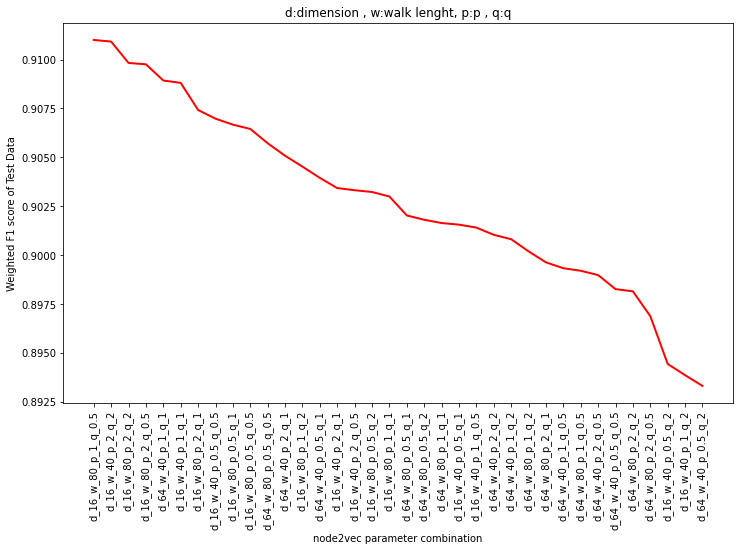

In [188]:
plt.figure(figsize=(12,7))
plt.plot(grid_map2.grid_name,grid_map2.test_weighted_f1,color="r",lw=2)
plt.xticks(grid_map2.grid_name, grid_map2.grid_name, rotation='vertical')
plt.xlabel("node2vec parameter combination")
plt.ylabel("Weighted F1 score of Test Data")
plt.title("d:dimension , w:walk lenght, p:p , q:q")
plt.show()

Best node2vec parameter combination is : embs16

    -Dimension:16
    -Walk lenght : 80
    -p=1
    -q=0.5
    -number of walks = 10
    
Best CV score: 0.908368 using the following RF Grid 

    -clf__class_weight': 'balanced'
    -clf__criterion': 'gini'
    -clf__max_depth': 10
    -clf__max_features': 10
    -clf__min_samples_leaf': 1
    -clf__min_samples_split': 3

    -Grid accuracy on training data: 0.958431421320217
    -Grid accuracy on test data: 0.9109995106063957
    -test f1 0.9109995106063957
    -train f1 0.958431421320217


# Feature Importances

In [189]:
embs = pd.read_csv("embs16.txt", sep=' ', skiprows=1, header=None, index_col = 0)
modelling_data_emb = embs.merge(modelling_data,right_index=True, left_index=True)
X = modelling_data_emb.iloc[:,:-1]
y = modelling_data_emb.iloc[:,-1]
X_train, X_test, y_train, y_test = mod.train_test_split(X, y, test_size=0.2, random_state=42, stratify = y)
modelling_data_emb.head(2)

,1,2,3,4,5,6,7,8,9,10,...,betweenness_centrality,clustring_coef,pagerank,closeness_centrality,degree,number_of_cliques,number_of_communities,size_maximal_clique,size_community,page_type
19743,0.404560,-0.279175,0.233266,0.741990,0.231701,0.567750,0.340650,0.142214,-0.197396,0.056437,...,0.039805,0.042501,0.001011,0.317413,678,14333,2,17,3704,government
21729,0.393925,-0.262306,0.203577,0.694507,0.272107,0.599882,0.338398,0.181458,-0.200642,0.016477,...,0.039820,0.042682,0.000984,0.317475,659,14335,2,17,3704,government


In [230]:
pipe_categoric = pip.Pipeline([
                                ("ohe",pre.OneHotEncoder(handle_unknown="ignore", sparse=False))
                              ])
pipe_numeric = pip.Pipeline([
                                ("scaler", pre.StandardScaler()),
                             ])

ct = com.ColumnTransformer([
                           ("num", pipe_numeric, num_list),
                           ("cat", pipe_categoric, ["number_of_communities"]), # This columns includes community Id. It needs to be one hot encoded
                           ],remainder="passthrough")

pipeline_hand_maid = pip.Pipeline([ 
                                  ("ct", ct),
                                  ("pca", dec.PCA(n_components=20)),
                                  ])

ct2 = com.ColumnTransformer([
                           ("handmaid", pipeline_hand_maid, hand_maid)],
                            remainder="passthrough")

pipeline = pip.Pipeline([ 
                        ("ct2", ct2),
                        ('clf', ens.RandomForestClassifier(random_state=42))
                        ])

params = {
            'clf__criterion': ['gini'],
            'clf__max_features': [10],
            'clf__max_depth': [10],
            'clf__min_samples_leaf': [1],
            'clf__min_samples_split': [3],
            'clf__class_weight':["balanced"]}

kfold = mod.StratifiedKFold(n_splits=3)
grid  = mod.GridSearchCV(estimator=pipeline, param_grid=params, cv=kfold, scoring=met.make_scorer(met.f1_score, average='weighted'),verbose=1,n_jobs=-1)
grid.fit(X_train,y_train)


Fitting 3 folds for each of 1 candidates, totalling 3 fits


GridSearchCV(cv=StratifiedKFold(n_splits=3, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('ct2',
                                        ColumnTransformer(remainder='passthrough',
                                                          transformers=[('handmaid',
                                                                         Pipeline(steps=[('ct',
                                                                                          ColumnTransformer(remainder='passthrough',
                                                                                                            transformers=[('num',
                                                                                                                           Pipeline(steps=[('scaler',
                                                                                                                                            StandardScaler())]),
                                    

In [235]:
print(); print("Best CV score: %f using %s\n" % (grid.best_score_, grid.best_params_))
print('Grid accuracy on training data:', grid.score(X_train, y_train))
print('Grid accuracy on test data:', grid.score(X_test, y_test))
print("test f1",met.f1_score(y_test, grid.predict(X_test), average='weighted'))
print("train f1",met.f1_score(y_train, grid.predict(X_train), average='weighted'))



Best CV score: 0.908091 using {'clf__class_weight': 'balanced', 'clf__criterion': 'gini', 'clf__max_depth': 10, 'clf__max_features': 10, 'clf__min_samples_leaf': 1, 'clf__min_samples_split': 3}

Grid accuracy on training data: 0.95877068026003
Grid accuracy on test data: 0.9094281904613126
test f1 0.9094281904613126
train f1 0.95877068026003


In [234]:
print(met.classification_report(y_test,grid.predict(X_test)))

              precision    recall  f1-score   support

     company       0.93      0.90      0.91      1299
  government       0.90      0.93      0.91      1376
  politician       0.92      0.93      0.93      1154
      tvshow       0.89      0.84      0.86       665

    accuracy                           0.91      4494
   macro avg       0.91      0.90      0.90      4494
weighted avg       0.91      0.91      0.91      4494



In [198]:
x_train_features = pipeline[0].fit_transform(X_train)
x_train_features= pd.DataFrame(x_train_features)

Feature ranking:
 1.              34 34 (0.092746)
 2.              24 24 (0.070151)
 3.              27 27 (0.066045)
 4.              35 35 (0.064189)
 5.              29 29 (0.052460)
 6.              23 23 (0.049144)
 7.              22 22 (0.049133)
 8.              12 12 (0.046352)
 9.              30 30 (0.044311)
10.              28 28 (0.041656)
11.              21 21 (0.041461)
12.              32 32 (0.034343)
13.              25 25 (0.032811)
14.              33 33 (0.031646)
15.              26 26 (0.027103)
16.              19 19 (0.021416)
17.              20 20 (0.019873)
18.               2  2 (0.018305)
19.              10 10 (0.018078)
20.               9  9 (0.017835)
21.               8  8 (0.016441)
22.              15 15 (0.014863)
23.               5  5 (0.013756)
24.               1  1 (0.013521)
25.              31 31 (0.013010)
26.              16 16 (0.012904)
27.              14 14 (0.012504)
28.               0  0 (0.012486)
29.              18 18 (0.00958

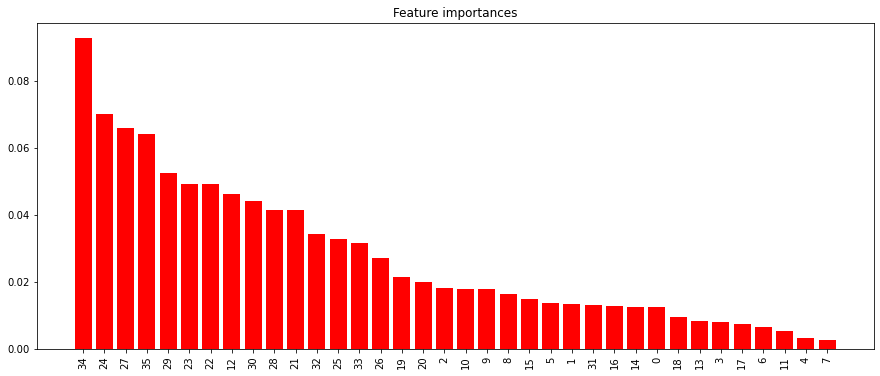

In [208]:
importances = grid.best_estimator_.named_steps["clf"].feature_importances_
std = np.std([grid.best_estimator_.named_steps["clf"].feature_importances_ for tree in  grid.best_estimator_.named_steps["clf"].estimators_], axis=0)
indices = np.argsort(importances)[::-1]
feature_names = x_train_features.columns.tolist()
# Print the feature ranking
print("Feature ranking:")
feature_list = []
for f in range(x_train_features.shape[1]):
    feature_list.append(feature_names[indices[f]])
    print("%2d. %15s %2d (%f)" % (f + 1, feature_names[indices[f]], indices[f], importances[indices[f]]))
# Plot the feature importances of the forest
plt.figure(figsize=(15,6))
plt.title("Feature importances")
plt.bar(range(x_train_features.shape[1]), importances[indices],
       color="r", yerr=std[indices], align="center")
plt.xticks(range(x_train_features.shape[1]), feature_list, rotation='vertical')
#plt.xlim([-1, x_train_features.shape[1]])
plt.show()

Indexes bw 0-19 are hand engineered features:
   
Source:Documentation of ColumnTransformer:
Notes

The order of the columns in the transformed feature matrix follows the order of how the columns are specified in the transformers list. Columns of the original feature matrix that are not specified are dropped from the resulting transformed feature matrix, unless specified in the passthrough keyword. Those columns specified with passthrough are added at the right to the output of the transformers.
https://scikit-learn.org/stable/modules/generated/sklearn.compose.ColumnTransformer.html#sklearn.compose.ColumnTransformer.get_feature_names

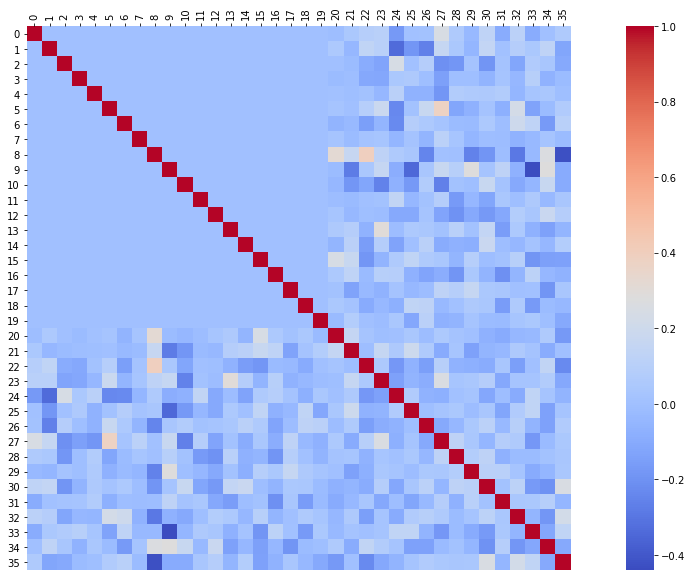

In [219]:
correlation_matrix = x_train_features.corr()
plt.figure(figsize=(20,10))
ax = sns.heatmap(correlation_matrix, vmax=1, cbar=True, square=True, annot=False, fmt='.2f', 
                 cmap='coolwarm')
ax.xaxis.set_ticks_position('top')
plt.yticks(rotation=0)
plt.xticks(rotation=90)
plt.show()

# TSNE Visualization of the feature set

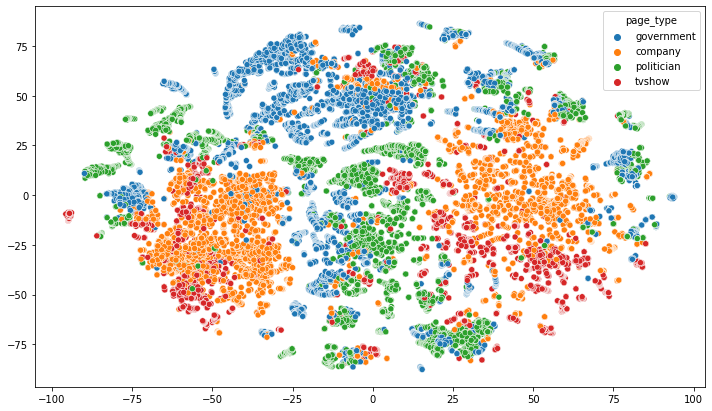

In [177]:
pipe_pca_tsne = pip.Pipeline([ 
                        ("ct2", ct2),
                        ("tsne", man.TSNE(n_components=2))
                        ])
X_tsne = pipe_pca_tsne.fit_transform(X)
plt.figure(figsize=(12,7))
sns.scatterplot(x=X_tsne[:, 0], y=X_tsne[:,1], hue=y)
plt.show()

# Performance of the hand enginered features

In [236]:
embs = pd.read_csv("embs16.txt", sep=' ', skiprows=1, header=None, index_col = 0)
modelling_data_emb = embs.merge(modelling_data,right_index=True, left_index=True).drop(columns=hand_maid,axis=1)
modelling_data_emb.head(2)

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,page_type
19743,0.404560,-0.279175,0.233266,0.741990,0.231701,0.567750,0.340650,0.142214,-0.197396,0.056437,-0.467711,0.366032,-0.058051,-0.717815,-0.383605,0.644990,government
21729,0.393925,-0.262306,0.203577,0.694507,0.272107,0.599882,0.338398,0.181458,-0.200642,0.016477,-0.458164,0.407735,-0.049395,-0.727572,-0.357324,0.642049,government


In [237]:
X = modelling_data_emb.iloc[:,:-1]
y = modelling_data_emb.iloc[:,-1]
X_train, X_test, y_train, y_test = mod.train_test_split(X, y, test_size=0.2, random_state=42, stratify = y)

In [238]:
pipeline = pip.Pipeline(steps=[ 
                                ('clf', ens.RandomForestClassifier(random_state=42))
                              ])
params = {
    'clf__criterion':    ['gini'],
    'clf__max_features': [10],
    'clf__max_depth':    [10],
    'clf__min_samples_leaf':  [1],
    'clf__min_samples_split': [3],
    'clf__class_weight':[ "balanced"]}

kfold = mod.StratifiedKFold(n_splits=3)
grid  = mod.GridSearchCV(estimator=pipeline, param_grid=params, cv=kfold, scoring=met.make_scorer(met.f1_score, average='weighted'),verbose=1,n_jobs=-1)
grid.fit(X_train,y_train)


Fitting 3 folds for each of 1 candidates, totalling 3 fits


GridSearchCV(cv=StratifiedKFold(n_splits=3, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('clf',
                                        RandomForestClassifier(random_state=42))]),
             n_jobs=-1,
             param_grid={'clf__class_weight': ['balanced'],
                         'clf__criterion': ['gini'], 'clf__max_depth': [10],
                         'clf__max_features': [10],
                         'clf__min_samples_leaf': [1],
                         'clf__min_samples_split': [3]},
             scoring=make_scorer(f1_score, average=weighted), verbose=1)

In [240]:
print(); print("Best CV score: %f using %s\n" % (grid.best_score_, grid.best_params_))
print('Grid accuracy on training data:', grid.score(X_train, y_train))
print('Grid accuracy on test data:', grid.score(X_test, y_test))
print(met.classification_report(y_test,grid.predict(X_test)))
print("test f1",met.f1_score(y_test, grid.predict(X_test), average='weighted'))
print("train f1",met.f1_score(y_train, grid.predict(X_train), average='weighted'))



Best CV score: 0.909257 using {'clf__class_weight': 'balanced', 'clf__criterion': 'gini', 'clf__max_depth': 10, 'clf__max_features': 10, 'clf__min_samples_leaf': 1, 'clf__min_samples_split': 3}

Grid accuracy on training data: 0.9568528744399691
Grid accuracy on test data: 0.909057260291024
              precision    recall  f1-score   support

     company       0.93      0.90      0.91      1299
  government       0.89      0.94      0.91      1376
  politician       0.92      0.92      0.92      1154
      tvshow       0.89      0.85      0.87       665

    accuracy                           0.91      4494
   macro avg       0.91      0.90      0.90      4494
weighted avg       0.91      0.91      0.91      4494

test f1 0.909057260291024
train f1 0.9568528744399691


Hand enginered features improved model performance from 0.909 to 0.911

